<a href="https://colab.research.google.com/github/cagBRT/computer-vision/blob/master/opencv7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Chapter 7

In [ ]:
import numpy as np
import imutils
import cv2
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure

A histogram represents the distribution of pixel intensities (whether color or gray- scale) in an image. It can be visualized as a graph (or plot) that gives a high-level intuition of the intensity (pixel value) distribution. 

When plotting the histogram, the X-axis serves as our “bins”. If we construct a histogram with 256 bins, then we are effectively counting the number of times each pixel
value occurs. In contrast, if we use only 2 (equally spaced) bins, then we are counting the number of times a pixel is in the range [0, 128) or [128, 255]. The number of pixels binned to the x-axis value is then plotted on the y-axis.


cv2.calcHist(images,channels,mask,histSize,ranges)
1. images: This is the image that we want to compute a histogram for. Wrap it as a list: [myImage].
2. channels: This is a list of indexes, where we specify the index of the channel we want to compute a his- togram for. To compute a histogram of a grayscale image, the list would be [0]. To compute a histogram for all three red, green, and blue channels, the chan- nels list would be [0,1,2].
3. mask: Remember learning about masks in Chapter 6? Well, here we can supply a mask. If a mask is provided, a histogram will be computed for masked pixels only. If we do not have a mask or do not want to apply one, we can just provide a value of None.
4. histSize: This is the number of bins we want to use when computing a histogram. Again, this is a list, one for each channel we are computing a histogram for. The bin sizes do not all have to be the same. Here is an example of 32 bins for each channel: [32,32,32].
90
7.2 grayscale histograms
5. ranges: Here we specify The range of possible pixel values. Normally, this is [0, 256] for each channel, but if you are using a color space other than RGB (such as HSV), the ranges might be different.


Grayscale Histograms

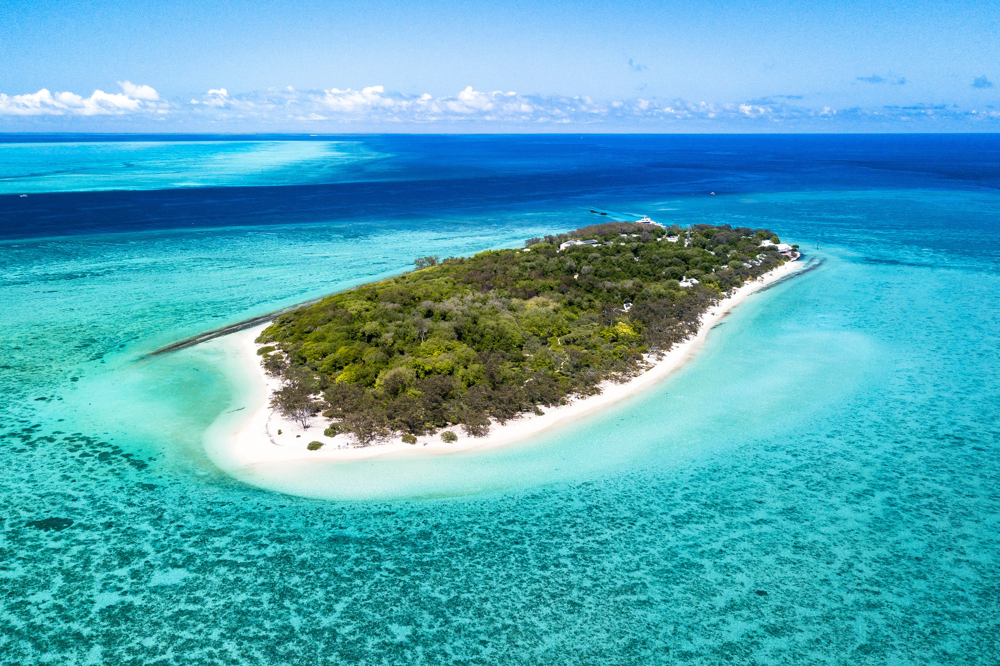

In [ ]:
image = cv2.imread("island.jpg")
cv2_imshow(image)

The bins (0-255) are plotted on the x-axis. And the y-axis counts the number of pixels in each bin. The majority of the pixels fall in the range of roughly 60 to 120. Looking at the right tail of the histogram, we see very few pixels in the range 200 to 255. This means that there are very few “white” pix- els in the image.

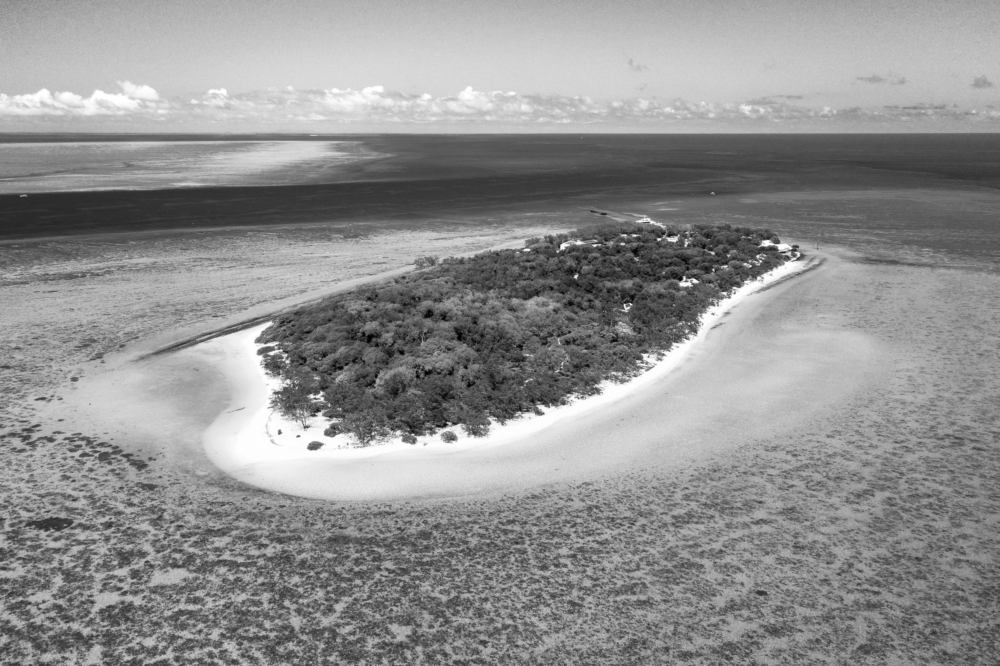

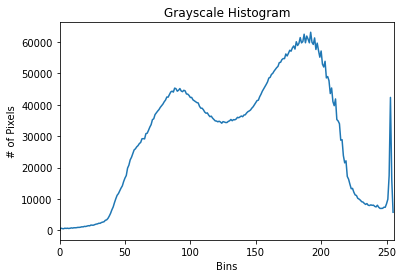

In [ ]:
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
cv2_imshow(image)

hist = cv2.calcHist([image], [0], None, [256], [0, 256])
plt.figure()
plt.title("Grayscale Histogram")
plt.xlabel("Bins")
plt.ylabel("# of Pixels")
plt.plot(hist)
plt.xlim([0, 256])
plt.show()

# Color Histogram

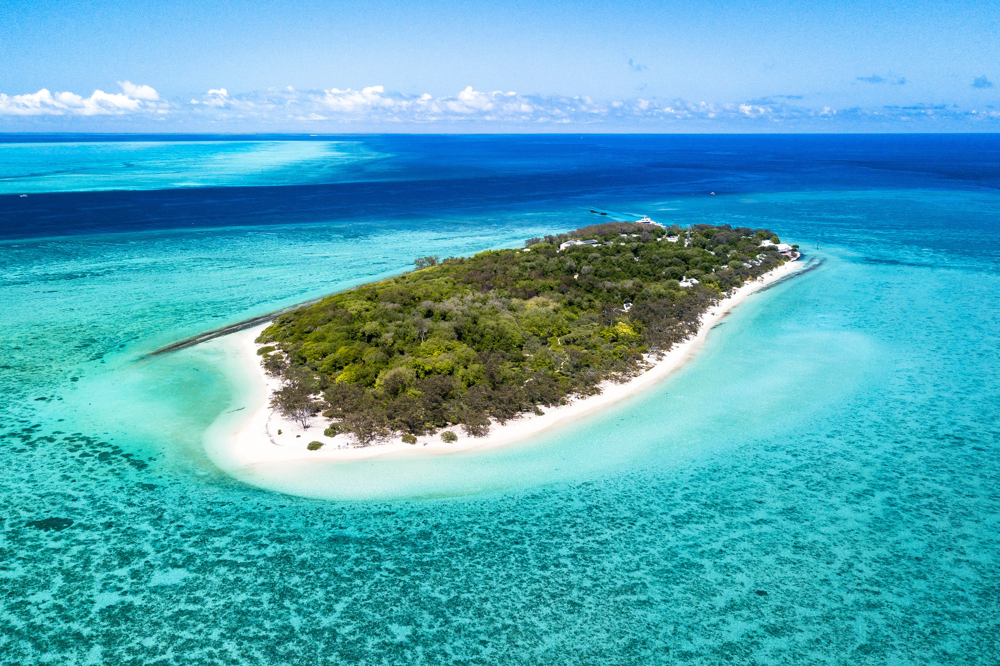

In [ ]:
image = cv2.imread("island.jpg")
cv2_imshow( image)

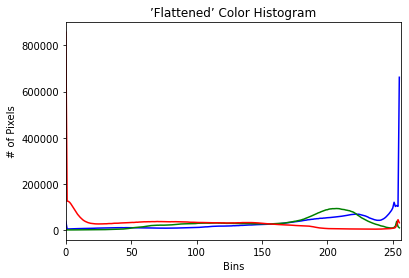

In [ ]:
chans = cv2.split(image)
colors = ("b", "g", "r")
plt.figure()
plt.title("’Flattened’ Color Histogram") 
plt.xlabel("Bins")
plt.ylabel("# of Pixels")
for (chan, color) in zip(chans, colors):
  hist = cv2.calcHist([chan], [0], None, [256], [0, 256]) 
  plt.plot(hist, color = color)
  plt.xlim([0, 256])

Explain multi-dimensional histograms by using
the word AND.
For example, we can ask a question such as, “How many pixels have a Red value of 10 AND a Blue value of 30?”. How many pixels have a Green value of 200 AND a Red value of 130? By using the conjunctive AND, we are able to construct multi-dimensional histograms.


2D histogram shape: (32, 32), with 1024 values


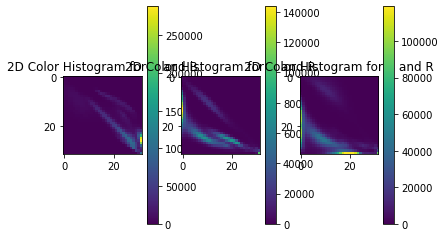

In [ ]:
fig = plt.figure() 

ax = fig.add_subplot(131)
hist = cv2.calcHist([chans[1], chans[0]], [0, 1], None,[32, 32], [0, 256, 0, 256])
p = ax.imshow(hist, interpolation = "nearest")
ax.set_title("2D Color Histogram for G and B")
plt.colorbar(p)

ax = fig.add_subplot(132)
hist = cv2.calcHist([chans[1], chans[2]], [0, 1], None,[32, 32], [0, 256, 0, 256])
p = ax.imshow(hist, interpolation = "nearest")
ax.set_title("2D Color Histogram for G and R")
plt.colorbar(p)

ax = fig.add_subplot(133)
hist = cv2.calcHist([chans[0], chans[2]], [0, 1], None,[32, 32], [0, 256, 0, 256])
p = ax.imshow(hist, interpolation = "nearest")
ax.set_title("2D Color Histogram for B and R")
plt.colorbar(p)

print("2D histogram shape: {}, with {} values".format(hist.shape, hist.flatten().shape[0]))

In [ ]:
hist = cv2.calcHist([image], [0, 1, 2],None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
print("3D histogram shape: {}, with {} values".format( hist.shape, hist.flatten().shape[0]))
plt.show()

3D histogram shape: (8, 8, 8), with 512 values


In [ ]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np
import argparse
import cv2

image = cv2.imread("island.jpg") 
size = float(10)
bins = int(10)
hist = cv2.calcHist([image], [0, 1, 2],None, [bins, bins, bins], [0, 256, 0, 256, 0, 256])
print("3D histogram shape: %s, with %d values" % ( hist.shape, hist.flatten().shape[0]))


3D histogram shape: (10, 10, 10), with 1000 values


In [ ]:
image = cv2.imread("island.jpg") 
size = float(20)
bins = int(20)
hist = cv2.calcHist([image], [0, 1, 2],None, [bins, bins, bins], [0, 256, 0, 256, 0, 256])
print("3D histogram shape: %s, with %d values" % ( hist.shape, hist.flatten().shape[0]))

3D histogram shape: (20, 20, 20), with 8000 values
